# **Esercitazione 2 - Evapotraspirazione**
L'evapotraspirazione (*ET*) descrive il processo combinato di due fenomeni: l'evaporazione dell'acqua dal suolo e l'evaporazione dell'acqua dalle piante, chiamata traspirazione. 

In entrambi i casi, il contributo di *ET* rimane difficile da stimare sia in condizioni di laboratorio, sia in ambiente. Esistono però alcuni modelli che permettono di valutare l'evapotraspirazione attraverso opportune ipotesi. 

L'obiettivo di questa parte di esercitazione è proprio quello di stimare l'evapotraspirazione in una data stazione attraverso due modelli diversi:
- Priestley - Taylor 
- Penman - Monteith  [FAO](https://www.fao.org/3/X0490E/x0490e06.htm)

Sarà poi possibile stimare l'evapotraspirazione tenendo conto dello *stress factor* presente nella trattazione di Jarvis e osservare quindi le differenze tra i risultati ottenuti calcolandola in modo ideale e quelli che invece si ottengono nel secondo caso.

# Sommario
    
* [Evapotraspirazione - Priestley-Taylor](#Teoria) 
    - [Potenziale](#potenziale)
    - [Stress idrici](#water_stress)
    - [Stress ambientali](#environmental_stress)
    - [Effettiva](#actual_ET)
* [Confronto Evapotraspirazione Potenziale ed Effettiva](#confrontoET_PT)
* [Confronto Calore Latente Potenziale ed Effettivo](#confrontoLH_PT)

# Evapotraspirazione: Priestley-Taylor <a class="anchor" id="Teoria"></a>
Il modello di Priestley-Taylor (1972) permette di semplificare il calcolo della stima della evapotraspirazione.

\begin{equation}
ET_{0}^{PT} = \alpha\dfrac{\Delta\cdot (R_{n} - G)}{\Delta+\gamma}
\end{equation}

L'unico parametro che governa questa equazione lineare è un coefficiente empirico in media pari a: $\alpha$ = $1.26$.

Dove:
- $ET_{0}$ (oppure $ET$) espressa in [$mm \cdot day^{−1}$] or [$mm\cdot hour^{−1}$]; 
- $R_{n}$: radiazione netta espressa in [$MJ \cdot m^{2} \cdot day^{−1}$] or [$MJ \cdot m^{2}\cdot h^{−1}$]; 
- $G$: flusso di calore dal suolo espresso in [$MJ \cdot m^{2} \cdot day^{−1}$] or [$MJ \cdot m^{2}\cdot h^{−1}$]; 
- $\Delta$: pendenza della curva di tensione di vapore espressa in [$KP_{a}\dot °C^{−1}$]; 
- $\gamma$: costante psicometrica espressa in [$KP_{a} \cdot$ °$C^{−1}$]; 

All'interno del modello ci sono altri due parametri da specificare che regolano la partizione della radiazione netta diurna e notturna, che influiscono sul valore del flusso di calore dal suolo $G$:

\begin{equation}
 G =  \begin{cases}
   G_{morn}\cdot R_{n} \quad diurna \\G_{night}\cdot R_{n} \quad notturna
   \end{cases} 
\end{equation}

Con $G_{morn}$ e $G_{night}$ i coefficienti del flusso di calore dal suolo per le ore diurne e notturne rispettivamente.

Per questa simulazione è stata ipotizzata la presenza di una foresta di conifere situata in prossimità del centroide, realtivo alla stazione di Cavone, in un periodo di circa due anni: dal 15/12/2013 al 16/12/2015.

La scelta del tipo di vegetazione e di suolo va poi a influenzare i parametri input per il programma. In particolare, basandosi sulle tabelle *FAO*, sono stati presi come parametri relativi a un suolo *silt-loam* e a una coltura di conifere:
- $\theta_{FC}$ (*Water Field Capacity*), contenuto d'acqua relativo a una condizione di equilibrio tra forza di gravità e forza di capillarità, pari a: $0.29$ [-]
- $\theta_{WC}$ (*Water Wilting Point*), contenuto d'acqua in corrispondenza del punto di appassimento, pari a: $0.15$ [-]
- $Z_r$ (*roots depth*) corrisponde alla profondità delle radici : $1.25$ [$m$]
- $p$ (*Depletion Fraction*) è la frazione media della *TAW* (*Total Available Soil Water*) che può essere consumata dalle radici prima di arrivare a stress idrico; in questo caso pari a: $0.7$ [-]
- $K_{c, end}$ (*Crop Coefficient*) coefficiente che descrive gli effetti delle caratteristiche del raccolto sullo stress idrico del suolo, posto pari a : $1$ [-]
- Altezza della pianta: $10$[$m$]

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Image
import plotly.express as px
import os
import plotly.graph_objects as go

In [2]:
#os.getcwd()

In [3]:
os.chdir(os.path.join(os.getcwd(), "..", "output", "Cavone", "1"))
os.listdir()

['.DS_Store',
 'ActualET_PT_1.csv',
 'ActualEvapoTranspiration_FAO_1.csv',
 'ActualEvapotranspiration_PT_1.csv',
 'ActualLatentHeat_FAO_1.csv',
 'ActualLatentHeat_PT_1.csv',
 'ActualLH_PT_1.csv',
 'app_tot_ET_FAO_1.csv',
 'app_tot_LH_FAO_1.csv',
 'canopy_1_environmentalstress.csv',
 'canopy_1_potential.csv',
 'canopy_1_totalstress.csv',
 'canopy_1_waterstress.csv',
 'CI_ET_FAO_1.csv',
 'CI_EvapoTranspiration_FAO_1.csv',
 'CI_LatentHeat_FAO_1.csv',
 'CI_LH_FAO_1.csv',
 'Con_canopy_1_environmentalstress.csv',
 'Con_canopy_1_potential.csv',
 'Con_canopy_1_totalstress.csv',
 'Con_canopy_1_waterstress.csv',
 'Con_FluxTranspiration_1_environmentalstress.csv',
 'Con_FluxTranspiration_1_potential.csv',
 'Con_FluxTranspiration_1_totalstress.csv',
 'Con_FluxTranspiration_1_waterstress.csv',
 'Con_LH_Shade_1_environmentalstress.csv',
 'Con_LH_Shade_1_potential.csv',
 'Con_LH_Shade_1_totalstress.csv',
 'Con_LH_Shade_1_waterstress.csv',
 'Con_LH_Sun_1_environmentalstress.csv',
 'Con_LH_Sun_1_potent

## Evapotraspirazione Potenziale <a class="anchor" id="potenziale"></a>

Applicando la relazione del modello di Priestley-Taylor senza porre alcun tipo di stress né ambientali né idrici si ottiene che:

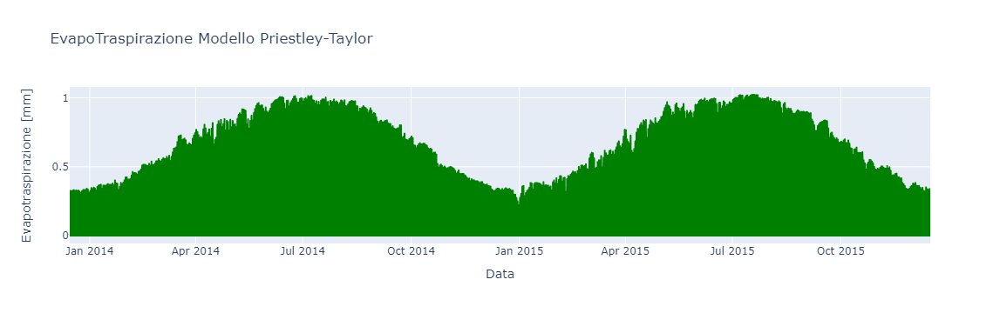

In [4]:
df = pd.read_csv('ET_PT_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df.columns = ['Data','Evapotraspirazione [mm]']
fig = px.line(df, x='Data', y='Evapotraspirazione [mm]', title='EvapoTraspirazione Modello Priestley-Taylor')
fig.update_traces(line_color='green')
#fig.update_xaxes(rangeslider_visible=True)
fig.show()

Si può osservare dal grafico che la variazione di tale fenomeno dipende considerevolmente dal tempo, con un andamento sinusoidale: in entrambi gli anni si manifestano due picchi in corrispondenza del periodo estivo, mentre i periodi invernali coincidono con i minimi valori di Evapotraspirazione. 

### Calore latente potenziale 

Per avere un ulteriore accertamento della correttezza dei nostri dati, è possibile valutare il variare del calore latente nel tempo, espresso in [$W \cdot m^{−2}$]:

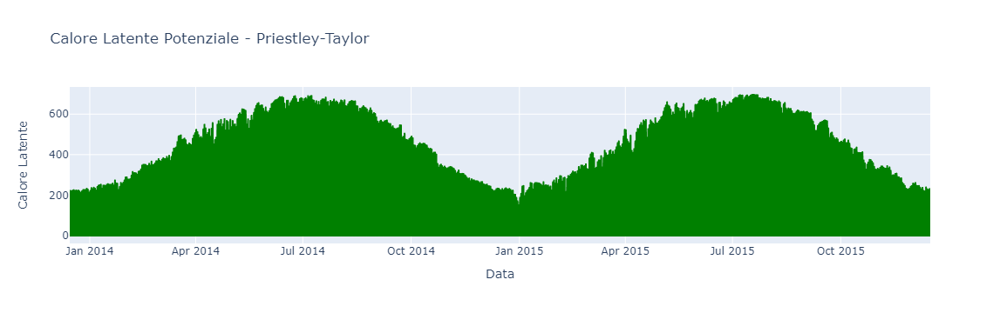

In [5]:
df2 = pd.read_csv('melo_p_LH_PT_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df2.columns = ['Data','Calore Latente']
fig2 = px.line(df2, x='Data', y='Calore Latente', title='Calore Latente Potenziale - Priestley-Taylor')
fig2.update_traces(line_color='green')
fig2.show()

Si può osservare che l'andamento ottenuto coincide con quello dell'evapotraspirazione.

## Stress Idrici <a class="anchor" id="water_stress"></a>

è possibile poi stimare l'evapotraspirazione stressata da un deficit di acqua:

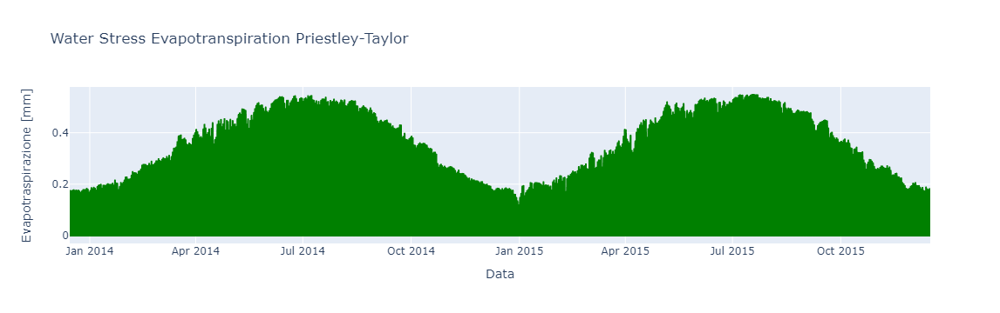

In [6]:
df3 = pd.read_csv('WaterStressed_ET_PT_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df3.columns = ['Data','Evapotraspirazione [mm]']
fig = px.line(df3, x='Data', y='Evapotraspirazione [mm]', title='Water Stress Evapotranspiration Priestley-Taylor')
fig.update_traces(line_color='green')
#fig.update_xaxes(rangeslider_visible=True)
fig.show()

In [7]:
df4 = pd.read_csv('melo_w_LH_PT_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df4.columns = ['Data','Calore Latente']

## Stress ambientali  <a class="anchor" id="environmental_stress"></a>

Per finire, si può fare una stima di $ET$ limitandola da fattori ambientali, applicando quindi gli stress relativi a:
- temperatura dell'aria
- radiazione
- Tensione di vapore

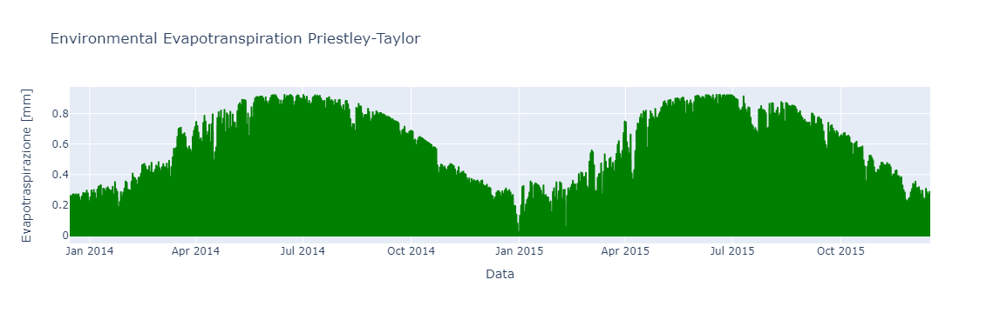

In [8]:
df5 = pd.read_csv('Environmental_ET_PT_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df5.columns = ['Data','Evapotraspirazione [mm]']
fig = px.line(df5, x='Data', y='Evapotraspirazione [mm]', title='Environmental Evapotranspiration Priestley-Taylor')
fig.update_traces(line_color='green')
#fig.update_xaxes(rangeslider_visible=True)
fig.show()

In [9]:
df6 = pd.read_csv('Environmental_LH_PT_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df6.columns = ['Data','Calore Latente']

## Evapotraspirazione Effettiva  <a class="anchor" id="actual_ET"></a>
Considerando singolarmente prima il deficit idrico, relativo al contenuto d'acqua nel suolo, e in seguito gli stress relativi alle condizioni ambientali (temperatura dell'aria, Radiazione, tensione di vapore) si è visto che l'evapotraspirazione non varia nel primo caso.

Infine, è possibile stimare *ET* considerando sia il deficit idrico sia gli stress relativi alle condizioni ambientali:

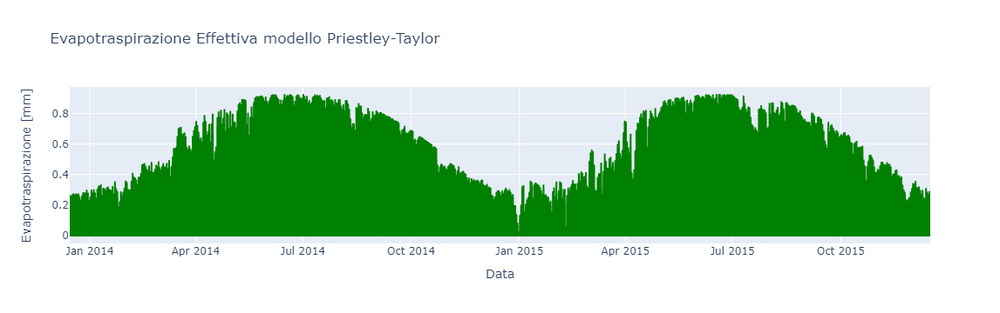

In [10]:
df7 = pd.read_csv('ActualET_PT_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df7.columns = ['Data','Evapotraspirazione [mm]']
fig = px.line(df7, x='Data', y='Evapotraspirazione [mm]', title='Evapotraspirazione Effettiva modello Priestley-Taylor')
fig.update_traces(line_color='green')
#fig.update_xaxes(rangeslider_visible=True)
fig.show()

In [11]:
df8 = pd.read_csv('ActualLH_PT_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df8.columns = ['Data','Calore Latente']

## Confronto della Evapotraspirazione Potenziale ed Effettiva  <a class="anchor" id="confrontoET_PT"></a>

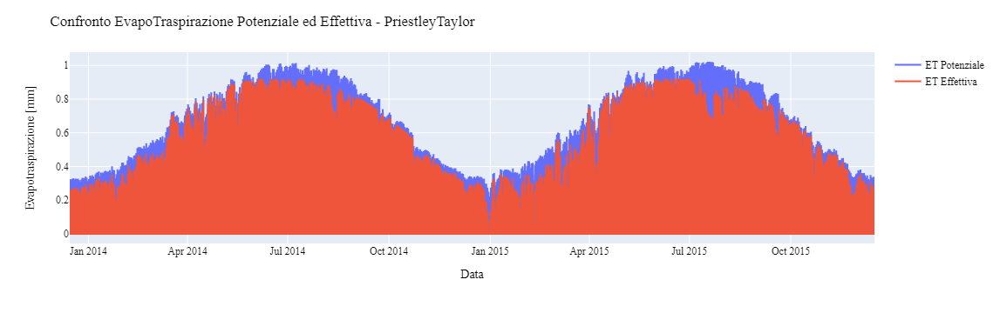

In [12]:
fig = px.line()
fig.add_trace(go.Scatter(x=df['Data'], y=df['Evapotraspirazione [mm]'], mode='lines', name='ET Potenziale'))
fig.add_trace(go.Scatter(x=df7['Data'], y=df7['Evapotraspirazione [mm]'], mode='lines', name='ET Effettiva'))

fig.update_layout(
    title='Confronto EvapoTraspirazione Potenziale ed Effettiva - PriestleyTaylor ',
    xaxis_title= "Data",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="Evapotraspirazione [mm]",
    #legend_title="Date",
    font=dict(size=12))
fig.show()

Si osserva che, oltre ad avere lo stesso andamento in entrambe le curve, il valore potenziale è effettivamente maggiore della evapotraspirazione effettiva: il massimo valore relativo all'evapotraspirazione potenziale è di circa $1.0$ [$mm$], mentre il massimo relativo al valore stressato è attorno a: $0.9$ [$mm$]. 


## Confronto Calore Latente Potenziale e Effettivo  <a class="anchor" id="confrontoLH_PT"></a>

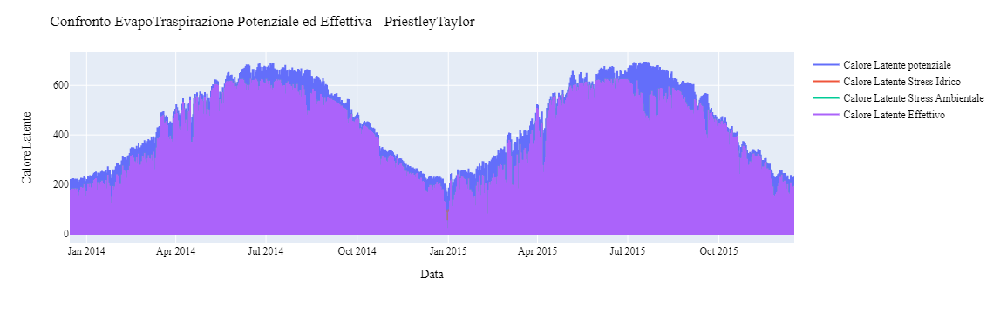

In [13]:
fig = px.line()
fig.add_trace(go.Scatter(x=df2['Data'], y=df2['Calore Latente'], mode='lines', name='Calore Latente potenziale'))
fig.add_trace(go.Scatter(x=df4['Data'], y=df4['Calore Latente'], mode='lines', name='Calore Latente Stress Idrico'))
fig.add_trace(go.Scatter(x=df6['Data'], y=df6['Calore Latente'], mode='lines', name='Calore Latente Stress Ambientale'))
fig.add_trace(go.Scatter(x=df8['Data'], y=df8['Calore Latente'], mode='lines', name='Calore Latente Effettivo'))

fig.update_layout(
    title='Confronto EvapoTraspirazione Potenziale ed Effettiva - PriestleyTaylor ',
    xaxis_title="Data",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="Calore Latente",
    #legend_title="Date",
    font=dict(size=12))
fig.show()